In [1]:
!pip install numpy
!pip install jax
!pip install matplotlib
!pip install ipywidgets
!pip install tonic
!pip install ipython

In [1]:
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
from ipywidgets import *
import tonic
import numpy as np
import matplotlib.animation as animation
from IPython import display

#Link to FFMPEG for animation 

plt.rcParams['animation.ffmpeg_path'] = '/opt/homebrew/Cellar/ffmpeg/6.0/bin/ffmpeg'

### Implementing interactive TDE plot (this could be moved to a .py import to be cleaner)

In [2]:
def spike_fn(x):
    out = jnp.zeros_like(x)
    out = jnp.where(x>0, 1.0, out)
    return out
    
def tde_example(tau_fac, tau_trg, tau_mem, time_step, n_time_steps, fac_in, trg_in):
    
    alpha   = jnp.exp(-time_step/tau_fac)
    beta    = jnp.exp(-time_step/tau_trg)
    gamma   = jnp.exp(-time_step/tau_mem)
    
    fac = jnp.zeros(fac_in.shape)
    trg = jnp.zeros(fac_in.shape)
    mem = jnp.zeros(fac_in.shape)
    
    mem_rec = []
    spk_rec = []
    fac_rec = []
    trg_rec = []
    
    for t in range(n_time_steps):
        mthr = mem-1.0
        out = spike_fn(mthr)
        
        new_fac = alpha*fac + fac_in[t]
        new_trg = beta*trg + new_fac*trg_in[t]
        new_mem = (gamma*mem + new_trg)*(1.0-out)
        
        mem_rec.append(mem)
        spk_rec.append(out)
        fac_rec.append(fac)
        trg_rec.append(trg)
    
        mem = new_mem
        fac = new_fac
        trg = new_trg
        
    return jnp.stack(mem_rec, axis=1), jnp.stack(spk_rec, axis=1), jnp.stack(fac_rec, axis=1), jnp.stack(trg_rec, axis=1)
        

In [3]:
def f(dt, tau_fac, tau_trg, tau_mem):
    
    fac_in = jnp.zeros(1000)
    fac_in = fac_in.at[200].set(1)

    trg_in = jnp.zeros(1000)
    trg_in = trg_in.at[200 + int(dt)].set(1)
    
    mem_rec, spk_rec, fac_rec, trg_rec= tde_example(tau_fac=tau_fac, tau_trg=tau_trg, tau_mem=tau_mem, 
                                            time_step=0.001, n_time_steps=1000, fac_in=fac_in, trg_in=trg_in)
    
    return fac_rec[0], trg_rec[0], mem_rec[0], spk_rec[0], fac_in, trg_in


interactive(children=(IntSlider(value=1, description='dt', max=50, min=-25), FloatSlider(value=0.01, descripti…

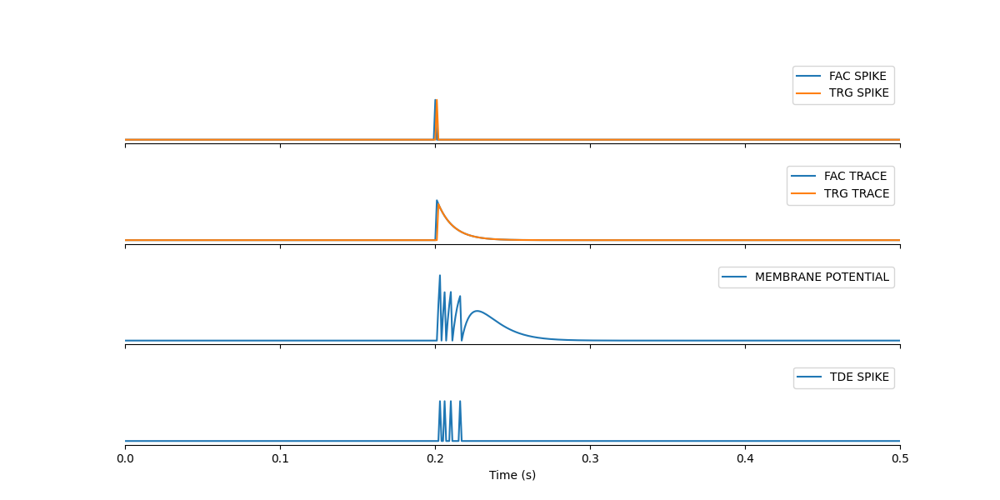

In [19]:
%matplotlib widget
x = jnp.linspace(0, 1, 1000)
fig, axs = plt.subplots(4, 1, sharex=True, sharey=True, figsize=(12, 6))

data = f(1, tau_fac=0.01, tau_trg=0.01, tau_mem=0.01)
fac_in, = axs[0].plot(x,data[4], label='FAC SPIKE')
trg_in, = axs[0].plot(x,data[5], label='TRG SPIKE')
fac, = axs[1].plot(x,data[0], label='FAC TRACE')
trg, = axs[1].plot(x,data[1], label='TRG TRACE')
mem, = axs[2].plot(x,data[2], label='MEMBRANE POTENTIAL')
spike, = axs[3].plot(x,data[3], label='TDE SPIKE')

axs[1].set_ylim(-.1, 2)
axs[0].set_xlim(0, 0.5)
axs[3].set_xlabel("Time (s)")

fig.canvas.toolbar_visible = False
fig.canvas.header_visible = False
fig.canvas.footer_visible = False

axs[0].legend()
axs[1].legend()
axs[2].legend()
axs[3].legend()

axs[0].yaxis.set_visible(False)
axs[1].yaxis.set_visible(False)
axs[2].yaxis.set_visible(False)
axs[3].yaxis.set_visible(False)

axs[0].spines[['right', 'top', 'left']].set_visible(False)
axs[1].spines[['right', 'top', 'left']].set_visible(False)
axs[2].spines[['right', 'top', 'left']].set_visible(False)
axs[3].spines[['right', 'top', 'left']].set_visible(False)

def update(dt=1, tau_fac=0.01, tau_trg=0.01, tau_mem=0.01):
    data = f(dt, tau_fac, tau_trg, tau_mem)
    fac_in.set_ydata(data[4])
    trg_in.set_ydata(data[5])
    fac.set_ydata(data[0])
    trg.set_ydata(data[1])
    mem.set_ydata(data[2])
    spike.set_ydata(data[3])
    fig.canvas.draw_idle()

interact(update, dt=(-25, 50, 1), tau_fac=(0.001, 0.1, 0.001), tau_trg=(0.001, 0.1, 0.001),
        tau_mem=(0.001, 0.1, 0.001));

plt.ioff()


### Import DVS Data

In [5]:
recording = 'mario_dvs_long.aedat4'

aer_format = tonic.io.read_aedat_header_from_file(recording)
rec = tonic.io.read_aedat4((recording))

cropped_size = (346,260) #CAN BE REDUCED TO LOWER COMPUTATIONAL OVERHEAD OF SIM

t_window = 20000 #This can be increased to further reduce computation (at cost of accuracy of course)

In [6]:
events = []

names = ['t', 'x', 'y', 'p']
formats = ['<i8','<i8','<i8','<i8']

dtype = np.dtype({'names': names, 'formats': formats})

start = rec[0][0]
end = rec[-1][0]

for i, v in enumerate(rec):
    
    if v[3] == True:
        pol = 1
    if v[3] == False:
        pol = 0

    events.append(np.asarray((v[0]-start, v[1],v[2], pol), dtype = dtype))

transform = tonic.transforms.Compose(
    [
        tonic.transforms.CenterCrop(sensor_size=(346, 260, 2), size=cropped_size),
        tonic.transforms.ToFrame(
            time_window=t_window,
            sensor_size=(*cropped_size, 2),
        ),
    ]
)

frames = transform(np.array(events))

total_time = (end - start)/1e6

time_step = total_time/len(frames)

print(f"total frames: {len(frames)} ")
print(f"total time: {total_time} ")

total frames: 1499 
total time: 29.995905 


### Animate frames

In [7]:
fig = plt.figure(figsize=(8, 8), dpi=100)
if frames[0].shape[0] == 2:
    first_frame = frames[0][1] - frames[0][0]
else:
    first_frame = frames[0][0]
ax = plt.imshow(first_frame)
plt.axis("off")

def animate(frame):
    if frame.shape[0] == 2:
        frame = frame[1] - frame[0]
    else:
        frame = frame[0]
    ax.set_data(frame)
    return ax

anim = animation.FuncAnimation(fig, animate, frames=frames, interval=time_step*1000)
video = anim.to_html5_video()
html = display.HTML(video)
display.display(html)
plt.close()


### Create FAC/TRG Event input tensors

In [8]:
stride = 2 #Pixel distance between FAC and TRG connections

fac_input = frames[:,0,:,:-stride].reshape(frames[:,0,:,:-stride].shape[0], -1)
trg_input = frames[:,0,:,stride:].reshape(frames[:,0,:,stride:].shape[0], -1)

### Redefine simulator for multiple inputs (could be integrated with above but im lazy)

In [9]:
def tde(tau_fac, tau_trg, tau_mem, time_step, n_time_steps, fac_in, trg_in):
    
    alpha   = jnp.exp(-time_step/tau_fac)
    beta    = jnp.exp(-time_step/tau_trg)
    gamma   = jnp.exp(-time_step/tau_mem)
    
    fac = jnp.zeros(fac_in.shape[1])
    trg = jnp.zeros(fac_in.shape[1])
    mem = jnp.zeros(fac_in.shape[1])
    
    mem_rec = []
    spk_rec = []
    fac_rec = []
    trg_rec = []
    
    for t in range(n_time_steps):
        mthr = mem-1.0
        out = spike_fn(mthr)
        
        new_fac = alpha*fac + fac_in[t]
        new_trg = beta*trg + new_fac*trg_in[t]
        new_mem = (gamma*mem + new_trg)*(1.0-out)
        
        mem_rec.append(mem)
        spk_rec.append(out)
        fac_rec.append(fac)
        trg_rec.append(trg)
    
        mem = new_mem
        fac = new_fac
        trg = new_trg
        
    return jnp.stack(mem_rec, axis=1), jnp.stack(spk_rec, axis=1), jnp.stack(fac_rec, axis=1), jnp.stack(trg_rec, axis=1)

### Run simulation for two populations (parameters can be played with) 

In [10]:
_, spk_recLR, _, _ = tde(tau_fac=0.02, tau_trg=0.05 , tau_mem=0.1, 
                                            time_step=total_time/(fac_input.shape[0]), n_time_steps=fac_input.shape[0], fac_in=fac_input, trg_in=trg_input)

_, spk_recRL, _, _ = tde(tau_fac=0.02, tau_trg=0.05, tau_mem=0.1, 
                                            time_step=total_time/(fac_input.shape[0]), n_time_steps=fac_input.shape[0], fac_in=trg_input, trg_in=fac_input)

### Make frames out network output

In [11]:
frames_tdeLR = spk_recLR.T.reshape(frames[:,0,:,stride:].shape)
frames_tdeRL = spk_recRL.T.reshape(frames[:,0,:,stride:].shape)

### Animate two populations

In [12]:
fig, ax = plt.subplots(1, 2, figsize=(8, 8), dpi=100)

def animate(frame):
    ax[0].clear()
    ax[0].imshow(frame[0], cmap='viridis', alpha = 1)
    ax[0].set_title('L $\\rightarrow$ R TDE Layer')
    ax[0].set_axis_off()
    ax[1].clear()
    ax[1].imshow(frame[1], cmap='viridis', alpha = 1)
    ax[1].set_title('R $\\rightarrow$ L TDE Layer')
    ax[1].set_axis_off()

anim = animation.FuncAnimation(fig, animate, frames=np.array(list(zip(frames_tdeLR,frames_tdeRL))), interval=total_time/(fac_input.shape[0]-1)*1000)
video = anim.to_html5_video()
html = display.HTML(video)
display.display(html)
plt.close()

### Plot pixelwise activity difference between population activity, top left value is differential frame spike count

### black = left motion
### white = right motion 

In [13]:
slowmo = 2 #slow down video by factor

fig, ax = plt.subplots(1, 1, figsize=(8, 8), dpi=100)
first_frame = frames_tdeLR[100]
ax = plt.imshow(first_frame, vmin = -1, vmax = 1, cmap='Greys')
text = plt.text(10, 20, 'test', color='white', size=20)
plt.axis("off")

def animate(frame):
    a = frame[1] - frame[0]
    ax.set_data(a)
    text.set_text(str(np.sum(frame[1])-np.sum(frame[0])))
    return ax

anim = animation.FuncAnimation(fig, animate, frames=np.array(list(zip(frames_tdeLR,frames_tdeRL))), interval=total_time/(fac_input.shape[0]-1)*1000*(slowmo))
video = anim.to_html5_video()
html = display.HTML(video)
display.display(html)
plt.close()


### Plot activity of populations overtime

In [17]:
plt.plot(np.sum(frames_tdeLR.reshape(frames_tdeLR.shape[0], -1), axis = 1))
plt.plot(np.sum(frames_tdeRL.reshape(frames_tdeRL.shape[0], -1), axis = 1))

In [18]:
diff = np.sum(-frames_tdeLR.reshape(frames_tdeLR.shape[0], -1), axis = 1) + np.sum(frames_tdeRL.reshape(frames_tdeRL.shape[0], -1), axis = 1)
plt.plot(diff)
